# Neurosynth supplementary figures
### Date: 11.03.2025

### **Note** that this notebook relies on ALE and C-SALE analyes and other previous output, such as the whole-brain probability distribution (the sum of foci kernels). 

We compared the distributions of voxels to those of foci (1a), and significant voxels (Supplements).
We update the null hypothesis in our new method, also illustrating the classic method (1b).
Then, we show results of behavioral domain-level analysis, with classic ALE (c) and C-SALE (d).
Lastly, we assess spatial correlations between domains and subdomains for ALE (e) and C-SALE (f) (+ Connected Supplements).

In [1]:
import os
import sys
import re
import glob
import nimare
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import seaborn as sns
from nilearn import plotting
import nilearn.maskers
import nilearn.image
import nilearn.surface
import nibabel
import itertools
import scipy
from tqdm import tqdm
import nimare_gpu
import SUITPy.flatmap
import scipy.cluster.hierarchy as sch
import statsmodels.stats.multitest

import warnings
warnings.filterwarnings("ignore")

# Define base directory of the project which is the parent of scripts folder
BASE_DIR = os.path.abspath('../..')
sys.path.append(os.path.join(BASE_DIR, 'scripts'))

import utils

# Defines input and output paths.
INPUT_DIR = os.path.join(BASE_DIR, 'input')
OUTPUT_DIR = os.path.join(BASE_DIR, 'output')
# Set up font style
plt.rcParams["font.family"] = "Asana Math"
plt.rcParams["font.size"] = 14
plt.rcParams["figure.dpi"] = 300

# Figure 1 Neurosynth Supplements

In [2]:
# create figures directory
FIGURES_DIR = os.path.join(OUTPUT_DIR, 'Figures')
figure_dir = os.path.join(FIGURES_DIR, 'Figure1')
supplementary_dir = os.path.join(figure_dir, 'Supplementary')
os.makedirs(supplementary_dir, exist_ok=True)

# S2. Replication of improvements of the cerebellum-specific ALE method over classic ALE for cerebellar meta-analysis

Create a mask of cerebellum based on Driedrichsen et al. 2009 atlas: (Before running this make sure that the `cerebellar_maps` submodule is pulled)

In [3]:
cerebellum_mask = utils.create_Diedrichsen2009_mask('MNI', dilation=0) 

Load XYZ of all coordinates reported in BrainMap within the cerebellar mask:

In [4]:
dump_path = os.path.join(OUTPUT_DIR, 'data', 'Neurosynth_dump.pkl.gz')
xyz_cerebellum = utils.get_null_xyz(
    dump_path,
    cerebellum_mask,
    unique=False
)

In [5]:
# get MNI coordinates of all cerebellum voxels (2mm space to reduce computational costs)
cerebellum_mask_img = nibabel.load(cerebellum_mask)
mask_ijk = np.vstack(np.where(cerebellum_mask_img.get_fdata() > 0)).T
mask_xyz = nibabel.affines.apply_affine(cerebellum_mask_img.affine, mask_ijk)

# Foci and Voxel Distributions across Z axis

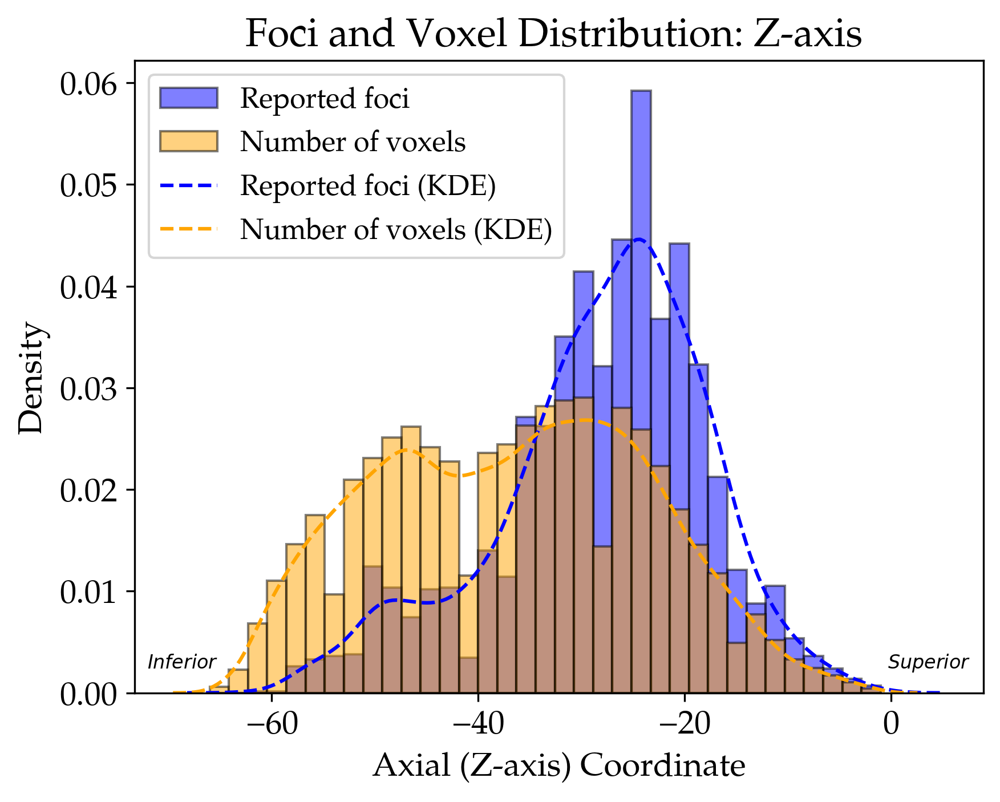

In [44]:
# Determine bins for the histograms based on both foci and voxels
bins = np.histogram_bin_edges(np.concatenate([xyz_cerebellum[:, 2], mask_xyz[:, 2]]), bins=35)

# Plot the histogram for the reported effects
plt.hist(xyz_cerebellum[:, 2], bins=bins, density=True, alpha=0.5, label='Reported foci', color='blue', edgecolor='black')

# Plot the histogram for the number of voxels
plt.hist(mask_xyz[:, 2], bins=bins, density=True, alpha=0.5, label='Number of voxels', color='orange', edgecolor='black')

# Optionally, add KDE for smoothed distribution
sns.kdeplot(xyz_cerebellum[:, 2], color='blue', label='Reported foci (KDE)', linestyle='--')
sns.kdeplot(mask_xyz[:, 2], color='orange', label='Number of voxels (KDE)', linestyle='--')

# Add legend and labels
plt.legend(fontsize=12, loc='upper left', bbox_to_anchor=(0.0, 1))
plt.xlabel('Axial (Z-axis) Coordinate')
plt.ylabel('Density')
plt.title('Foci and Voxel Distribution: Z-axis ')

# Add manual labels on the bottom left and right corners with offset
x_offset = 0.015 * (plt.xlim()[1] - plt.xlim()[0])
y_offset = 0.03 * (plt.ylim()[1] - plt.ylim()[0])

plt.text(x=plt.xlim()[0] + x_offset, y=plt.ylim()[0] + y_offset, 
         s='$\mathit{Inferior}$', ha='left', va='bottom', fontsize=8)
plt.text(x=plt.xlim()[1] - x_offset, y=plt.ylim()[0] + y_offset, 
         s='$\mathit{Superior}$', ha='right', va='bottom', fontsize=8)

# Foci and Voxel Distributions across X-axis

Text(73.09237415344703, 0.0005797635351836751, '$\\mathit{Right}$')

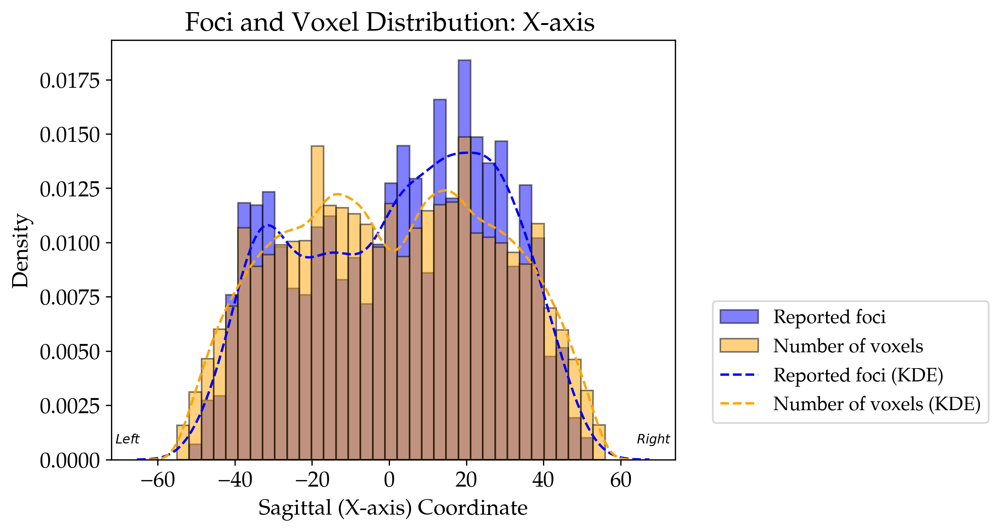

In [45]:
# Determine bins for the histograms based on both foci and voxels
bins = np.histogram_bin_edges(np.concatenate([xyz_cerebellum[:, 0], mask_xyz[:, 0]]), bins=35)

# Plot the histogram for the reported effects
plt.hist(xyz_cerebellum[:, 0], bins=bins, density=True, alpha=0.5, label='Reported foci', color='blue', edgecolor='black')

# Plot the histogram for the number of voxels
plt.hist(mask_xyz[:, 0], bins=bins, density=True, alpha=0.5, label='Number of voxels', color='orange', edgecolor='black')

# Optionally, add KDE for smoothed distribution
sns.kdeplot(xyz_cerebellum[:, 0], color='blue', label='Reported foci (KDE)', linestyle='--')
sns.kdeplot(mask_xyz[:, 0], color='orange', label='Number of voxels (KDE)', linestyle='--')

# Add legend and labels
plt.legend(fontsize=12, loc='upper left', bbox_to_anchor=(1.05, 0.4))
plt.xlabel('Sagittal (X-axis) Coordinate')
plt.ylabel('Density')
plt.title('Foci and Voxel Distribution: X-axis ')

# Add manual labels on the bottom left and right corners with offset
x_offset = 0.007 * (plt.xlim()[1] - plt.xlim()[0])
y_offset = 0.03 * (plt.ylim()[1] - plt.ylim()[0])

plt.text(x=plt.xlim()[0] + x_offset, y=plt.ylim()[0] + y_offset, 
         s='$\mathit{Left}$', ha='left', va='bottom', fontsize=8)
plt.text(x=plt.xlim()[1] - x_offset, y=plt.ylim()[0] + y_offset, 
         s='$\mathit{Right}$', ha='right', va='bottom', fontsize=8)

# Foci and Voxel Distributions across Y-axis

Text(-19.378111110497255, 0.0012788756469154705, '$\\mathit{Anterior}$')

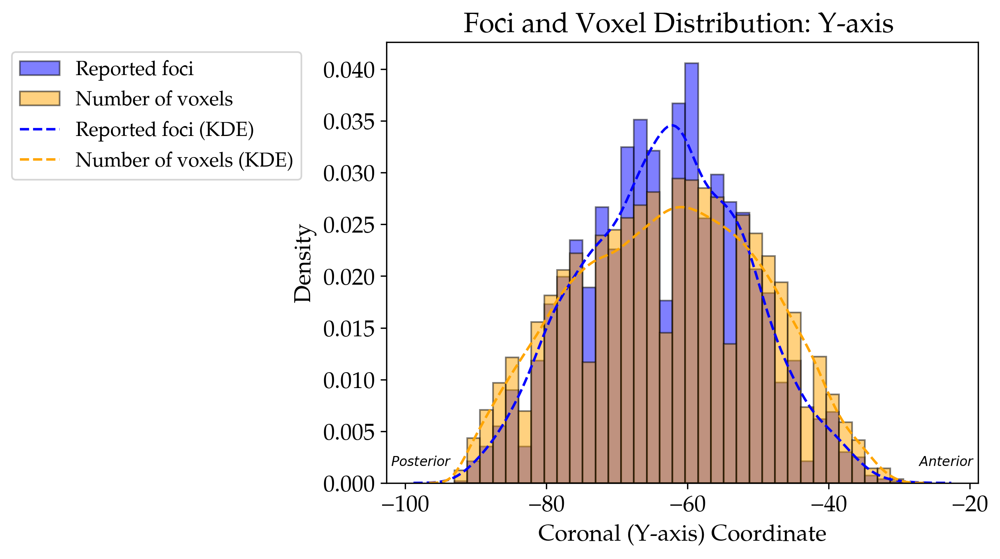

In [46]:
# Determine bins for the histograms based on both foci and voxels
bins = np.histogram_bin_edges(np.concatenate([xyz_cerebellum[:, 1], mask_xyz[:, 1]]), bins=35)

# Plot the histogram for the reported effects
plt.hist(xyz_cerebellum[:, 1], bins=bins, density=True, alpha=0.5, label='Reported foci', color='blue', edgecolor='black')

# Plot the histogram for the number of voxels
plt.hist(mask_xyz[:, 1], bins=bins, density=True, alpha=0.5, label='Number of voxels', color='orange', edgecolor='black')

# Optionally, add KDE for smoothed distribution
sns.kdeplot(xyz_cerebellum[:, 1], color='blue', label='Reported foci (KDE)', linestyle='--')
sns.kdeplot(mask_xyz[:, 1], color='orange', label='Number of voxels (KDE)', linestyle='--')

# Add legend and labels
plt.legend(fontsize=12, loc='upper left', bbox_to_anchor=(-0.65, 1))
plt.xlabel('Coronal (Y-axis) Coordinate')
plt.ylabel('Density')
plt.title('Foci and Voxel Distribution: Y-axis ')

# Add manual labels on the bottom left and right corners with offset
x_offset = 0.007 * (plt.xlim()[1] - plt.xlim()[0])
y_offset = 0.03 * (plt.ylim()[1] - plt.ylim()[0])

plt.text(x=plt.xlim()[0] + x_offset, y=plt.ylim()[0] + y_offset, 
         s='$\mathit{Posterior}$', ha='left', va='bottom', fontsize=8)
plt.text(x=plt.xlim()[1] - x_offset, y=plt.ylim()[0] + y_offset, 
         s='$\mathit{Anterior}$', ha='right', va='bottom', fontsize=8)

# Distribution of reported effects across whole brain

In [6]:
kernels_sum = utils.get_kernels_sum(dump_path)

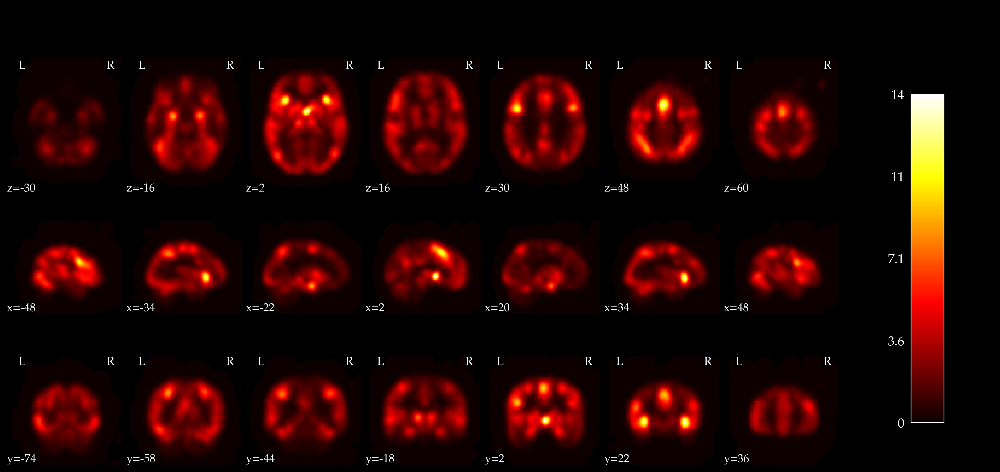

In [48]:
fig, ax = plt.subplots(figsize=(16, 8))
fig.patch.set_facecolor('black')

# Plot
display = plotting.plot_stat_map(
    kernels_sum, display_mode='mosaic', cut_coords=7, black_bg=True, colorbar=True,
    figure=fig, axes=ax
)

# Manually adjust color bar position to maximize figure space.
colorbar = display._cbar
colorbar.ax.set_position([0.95, 0.12, 0.03, 0.6])

# The sampling probability map in the cerebellum

Load the cerebellum dilated mask (used in the meta-analyses), mask the sum of kernels to it, and then normalize the sum to one.

We dilated the cerebellar mask 6mm in each direction to allow for effects slightly out of the mask (accounting for missalignments).

In [7]:
# create/load the dilated mask
cerebellum_mask_dilated = utils.create_Diedrichsen2009_mask('MNI', dilation=6)

# Resample the mask to the kernels sum map
cerebellum_mask_resampled = nilearn.image.resample_to_img(cerebellum_mask_dilated, kernels_sum, interpolation='nearest')

# normalize the sum to 1 to calculate sampling probability map in the cerebellum
kernels_sum_data = nibabel.load(kernels_sum).get_fdata()
kernels_sum_masked = kernels_sum_data[cerebellum_mask_resampled.get_fdata().astype(bool)]
sampling_prob = kernels_sum_masked / kernels_sum_masked.sum()

# project back the 1d sampling probability to 3D image
masker = nilearn.maskers.NiftiMasker(cerebellum_mask_resampled)
masker.fit()
sampling_prob_img = masker.inverse_transform(sampling_prob)
sampling_prob_surf = SUITPy.flatmap.vol_to_surf(sampling_prob_img, space='SPM').squeeze()

INFO:matplotlib.texmanager:font.family must be one of (serif, sans-serif, cursive, monospace) when text.usetex is True. serif will be used by default.
INFO:matplotlib.texmanager:font.family must be one of (serif, sans-serif, cursive, monospace) when text.usetex is True. serif will be used by default.
INFO:matplotlib.texmanager:font.family must be one of (serif, sans-serif, cursive, monospace) when text.usetex is True. serif will be used by default.
INFO:matplotlib.texmanager:font.family must be one of (serif, sans-serif, cursive, monospace) when text.usetex is True. serif will be used by default.
INFO:matplotlib.texmanager:font.family must be one of (serif, sans-serif, cursive, monospace) when text.usetex is True. serif will be used by default.
INFO:matplotlib.texmanager:font.family must be one of (serif, sans-serif, cursive, monospace) when text.usetex is True. serif will be used by default.
INFO:matplotlib.texmanager:font.family must be one of (serif, sans-serif, cursive, monospace) 

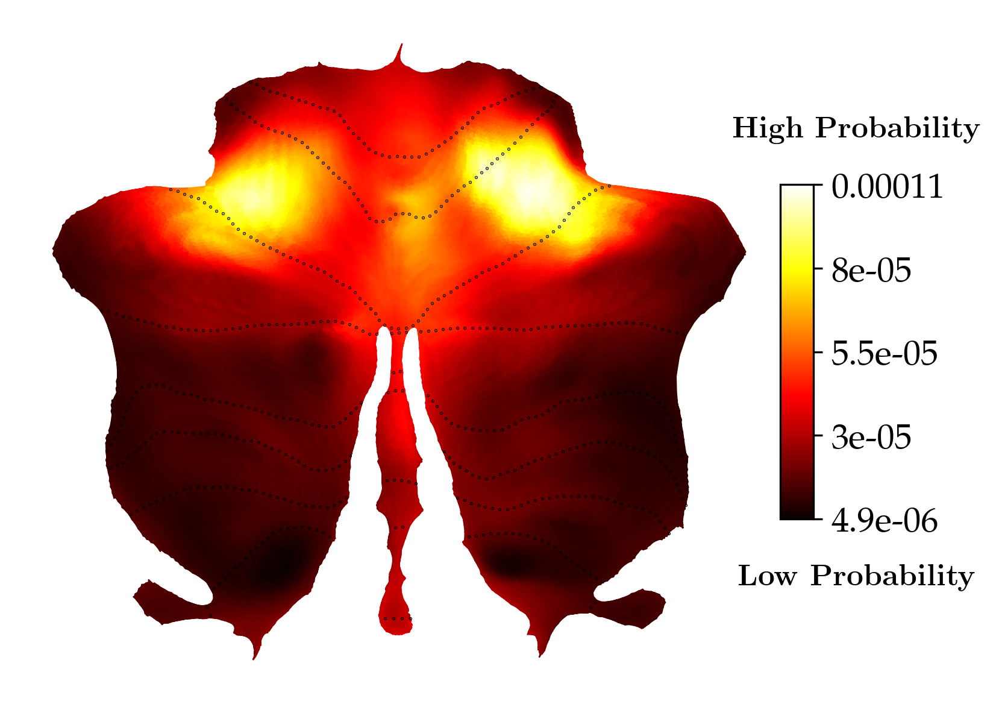

In [50]:
SUITPy.flatmap.plot(sampling_prob_surf, colorbar=True, new_figure=False, bordersize=0.5, cmap='hot')

# Get the current figure and axis
fig = plt.gcf()
ax = plt.gca()

# Add text labels to the figure with LaTeX formatting for bold text
plt.rcParams['text.usetex'] = True

fig.text(0.85, 0.235, r'$\textbf{Low Probability}$', va='center', ha='center', fontsize=12)
fig.text(0.85, 0.75, r'$\textbf{High Probability}$', va='center', ha='center', fontsize=12)

# Disable LaTex (important if causing issues with further plotting fonts).
plt.rcParams['text.usetex'] = False

Inset: See Figure 1 Notebook

### Correlation of sampling probability maps between BrainMap and Neurosynth

In [51]:
sampling_probs = {
    'Neurosynth': sampling_prob
}
kernels_sum = utils.get_kernels_sum(os.path.join(INPUT_DIR, 'BrainMap_dump_Feb2024.pkl.gz'))
# normalize the sum to 1 to calculate sampling probability map in the cerebellum
kernels_sum_data = nibabel.load(kernels_sum).get_fdata()
kernels_sum_masked = kernels_sum_data[cerebellum_mask_resampled.get_fdata().astype(bool)]
sampling_probs['BrainMap'] = kernels_sum_masked / kernels_sum_masked.sum()
scipy.stats.pearsonr(sampling_probs['Neurosynth'], sampling_probs['BrainMap'])

PearsonRResult(statistic=0.9623838086331907, pvalue=0.0)

# Classic ALE and C-SALE result maps for Behavioral Domains

Get experiment stats:

In [8]:
# Obtain the number of experiments from the exp_stats.csv
if os.path.exists(os.path.join(OUTPUT_DIR, 'exp_stats-NS.csv')):
    stats = pd.read_csv(os.path.join(OUTPUT_DIR, 'exp_stats-NS.csv'), index_col=0)
# If the stats file does not exist, create it from json files
else:
    stats = []
    for stats_path in glob.glob(os.path.join(OUTPUT_DIR, 'SALE', 'Neurosynth', '*', 'stats.json')):
        
        # Use regular expression to extract the value per  NeuroSynth term
        match = re.search(r'SALE/Neurosynth/([^/]+)/stats\.json$', stats_path)

        if match:
            term = match.group(1)
        else:
            continue 
            
        with open(stats_path, 'r') as f:
            curr_stats = json.load(f)
        curr_stats['term'] = term
        stats.append(curr_stats)
    stats = pd.DataFrame(stats).set_index('term').sort_index()
    # write to csv
    stats.to_csv(os.path.join(OUTPUT_DIR, 'exp_stats-NS.csv'))
# fix the removed " " between words
stats.index = pd.Series({t.replace(' ', ''): t for t in utils.neurosynth_terms}, name='term').loc[stats.index]
stats

,n_exp,n_foci,n_subs
term,,,
action,438,2021,8760
adaptation,145,695,2900
anticipation,137,588,2740
anxiety,187,717,3740
arousal,144,594,2880
...,...,...,...
verbal fluency,40,176,800
visual attention,58,263,1160
visual perception,43,189,860


Visualize the number of stats in a barplot

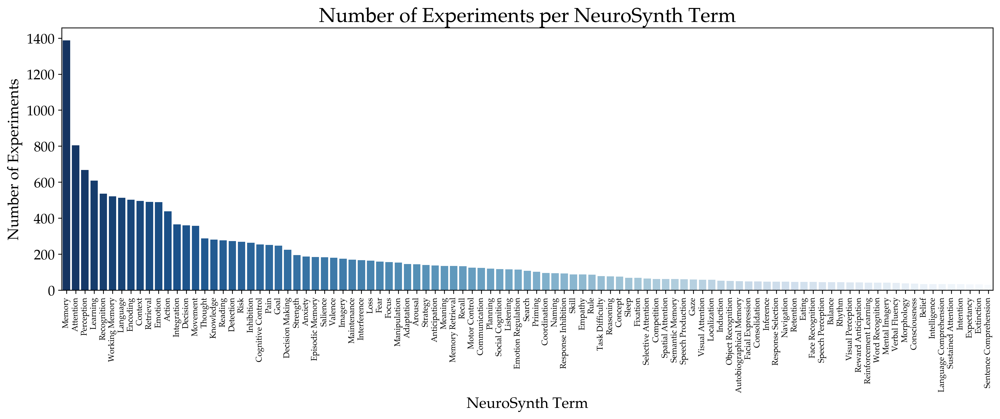

<Figure size 1920x1440 with 0 Axes>

In [53]:
# Sort by 'n_exp' in descending order
stats_sorted = stats.sort_values(by="n_exp", ascending=False)
stats_sorted.index = stats_sorted.index.str.title()

# Set figure size
plt.figure(figsize=(14, 6))

# Create barplot
sns.barplot(x="term", y="n_exp", data=stats_sorted, palette="Blues_r")

# Adjust labels
plt.xticks(rotation=90, fontsize=8)  # Rotate labels and make them smaller
plt.xlabel("NeuroSynth Term", fontsize=15)
plt.ylabel("Number of Experiments", fontsize=15)
plt.title("Number of Experiments per NeuroSynth Term", fontsize=20)

# Improve layout
plt.tight_layout()
plt.show()

Load the necessary maps

In [9]:
# Initialize dictionaries to store results 
surf_zmaps = {}
surf_zmaps_thr = {}
surf_cluster_boundary_coords = {}
terms = utils.neurosynth_terms

for analysis in ['ALE', 'SALE']:
    surf_zmaps[analysis] = {}
    surf_zmaps_thr[analysis] = {}
    surf_cluster_boundary_coords[analysis] = {}
    for term in terms:
        print(analysis, term)
        try:
            results = utils.load_results(analysis, term, source="Neurosynth")
        except FileNotFoundError:
            print(f"(Un)corrected {analysis} results not found for {term}")
            continue
        surf_zmaps[analysis][term] = results[analysis][term]['uncorr']
        surf_zmaps_thr[analysis][term] = results[analysis][term]['corr']
        surf_cluster_mask = (surf_zmaps_thr[analysis][term] > 0).astype(int)
        surf_cluster_boundary_coords[analysis][term] = utils.get_flatmap_mask_boundary_coords(surf_cluster_mask)

ALE action
ALE adaptation
ALE anticipation
ALE anxiety
ALE arousal
ALE attention
ALE autobiographical memory
ALE balance
ALE belief
ALE cognitive control
ALE communication
ALE competition
ALE concept
ALE consciousness
ALE consolidation
ALE context
ALE coordination
ALE decision
ALE decision making
ALE detection
ALE eating
ALE emotion
ALE emotion regulation
ALE empathy
ALE encoding
ALE episodic memory
ALE expectancy
ALE extinction
ALE face recognition
ALE facial expression
ALE fear
ALE fixation
ALE focus
ALE gaze
ALE goal
ALE imagery
ALE induction
ALE inference
ALE inhibition
ALE integration
ALE intelligence
ALE intention
ALE interference
ALE knowledge
ALE language
ALE language comprehension
ALE learning
ALE listening
ALE localization
ALE loss
ALE maintenance
ALE manipulation
ALE meaning
ALE memory
ALE memory retrieval
ALE mental imagery
ALE morphology
ALE motor control
ALE movement
ALE naming
ALE navigation
ALE object recognition
ALE pain
ALE perception
ALE planning
ALE priming
ALE read

## Classic ALE results for 5 preselected terms

Text(0.434, 1.15, 'Classic ALE')

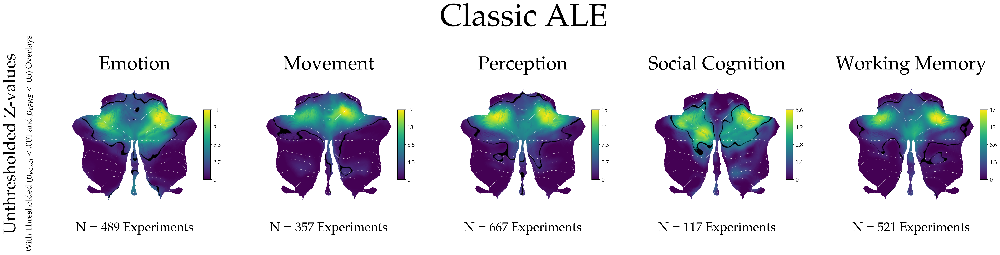

In [10]:
analysis = 'ALE'

# Define terms to loop over
terms_selection = ['emotion', 'movement', 'perception', 'social cognition', 'working memory'] # Selected and ordered manually. For all (significant) clusters, see figure 3.

# Create a new figure
fig = plt.figure(figsize=(40, 6)) 

# Loop over and create subplots for 5 selected terms
for i, term in enumerate(terms_selection):
    ax = fig.add_subplot(1,5, i + 1)

    # Plot themap for each domain
    SUITPy.flatmap.plot(surf_zmaps[analysis][term], colorbar=True, new_figure=False, bordersize=0.5, cmap = 'viridis', bordercolor='white')

    # Overlay the cluster borders on top
    ax.plot(surf_cluster_boundary_coords[analysis][term][:, 0], surf_cluster_boundary_coords[analysis][term][:, 1], color='black',
           marker='.', linestyle=None, markersize=0.01, linewidth=0)
    # Set titles and labels as needed
    ax.set_title(f"{term}".title(), fontsize = 45)
    
    ax.text(
        0.5, -0.1, 
        f'N = {stats.loc[term, "n_exp"]} Experiments', 
        fontsize=30, 
        ha='center', 
        va='center', 
        transform=ax.transAxes
    )

# Add a rotated y-label for the entire plot
fig.text(0.08, 0.5, 'Unthresholded Z-values', va='center', ha='center', rotation='vertical', fontsize=40)

# Add a subtitle for the y-label
fig.text(0.095, 0.5, 'With Thresholded ($\mathit{p_{voxel}}$ < .001 and $\mathit{p_{cFWE}}$ < .05) Overlays', va='center', ha='center', rotation='vertical', fontsize=20)

fig.text(0.434, 1.15, 'Classic ALE', fontsize=75)

## Cerebellum-specific ALE BD-level results

Text(0.355, 1.15, 'Cerebellum-specific ALE')

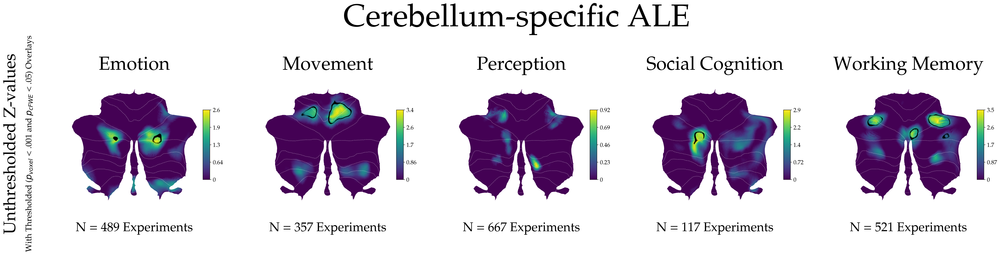

In [11]:
analysis = 'SALE'

# Define terms to loop over
terms_selection = ['emotion', 'movement', 'perception', 'social cognition', 'working memory'] # Selected and ordered manually. For all (significant) clusters, see figure 3.

# Create a new figure
fig = plt.figure(figsize=(40, 6)) 

# Loop over and create subplots for 5 selected terms
for i, term in enumerate(terms_selection):
    ax = fig.add_subplot(1,5, i + 1)

    # Plot themap for each domain
    SUITPy.flatmap.plot(surf_zmaps[analysis][term], colorbar=True, new_figure=False, bordersize=0.5, cmap = 'viridis', bordercolor='white')

    # Overlay the cluster borders on top
    ax.plot(surf_cluster_boundary_coords[analysis][term][:, 0], surf_cluster_boundary_coords[analysis][term][:, 1], color='black',
           marker='.', linestyle=None, markersize=0.01, linewidth=0)
    # Set titles and labels as needed
    ax.set_title(f"{term}".title(), fontsize = 45)
    
    ax.text(
        0.5, -0.1, 
        f'N = {stats.loc[term, "n_exp"]} Experiments', 
        fontsize=30, 
        ha='center', 
        va='center', 
        transform=ax.transAxes
    )

# Add a rotated y-label for the entire plot
fig.text(0.08, 0.5, 'Unthresholded Z-values', va='center', ha='center', rotation='vertical', fontsize=40)

# Add a subtitle for the y-label
fig.text(0.095, 0.5, 'With Thresholded ($\mathit{p_{voxel}}$ < .001 and $\mathit{p_{cFWE}}$ < .05) Overlays', va='center', ha='center', rotation='vertical', fontsize=20)

fig.text(0.355, 1.15, 'Cerebellum-specific ALE', fontsize=75)

# Cross-correlation of uncorrected Z-maps

Text(-0.2571735336135066, -0.5, 'T = 273.04, p < 0.001$^*$')

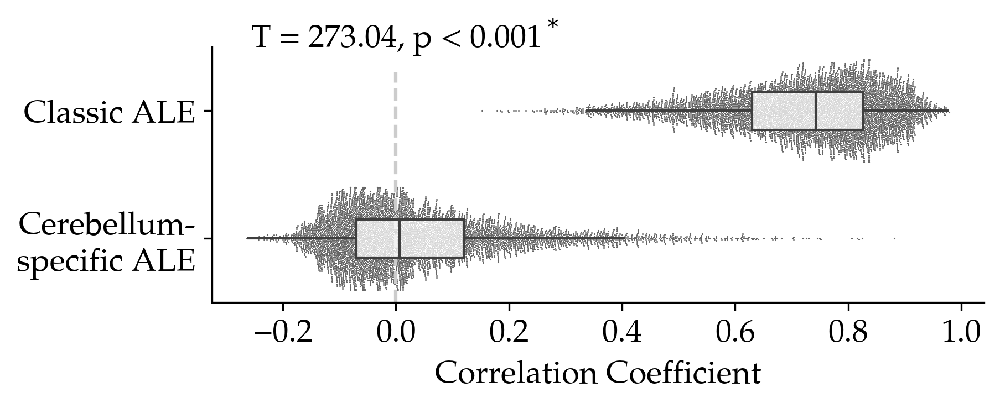

In [12]:
cross_corr = {}
for method in ['ALE', 'SALE']:
    cross_corr[method] = pd.DataFrame(surf_zmaps[method]).corr().values[np.tril_indices(len(surf_zmaps[method]), -1)]
cross_corr = pd.DataFrame(cross_corr)

fig, ax = plt.subplots(figsize=(6, 2))
plot_data = cross_corr.unstack().reset_index()
ax.axvline(0, color='.8', ls='--', ymax=0.9)
sns.swarmplot(
    data=plot_data,
    y='level_0', x=0,
    s=0.75, color='.4',
    ax=ax
)
sns.boxplot(
    data=plot_data,
    y='level_0', x=0,
    showfliers=False,
    showcaps=False, width=0.3,
    boxprops={"facecolor": (1, 1, 1, 0.75)},
    ax=ax)
plt.setp(ax.collections, zorder=0, label="") # puts swarm in the back
ax.set_xlabel('Correlation Coefficient')
ax.set_yticklabels(['Classic ALE', 'Cerebellum-\nspecific ALE'])
ax.set_ylabel('')
sns.despine()
# add statistics
t, p = scipy.stats.ttest_rel(
    cross_corr['ALE'], 
    cross_corr['SALE'])
if p > 0.001:
    text = f'T = {t:.2f}, p = {p:.3f}'
else:
    text = f'T = {t:.2f}, p < 0.001'
if p < 0.05:
    text+=r'$^*$'
text_x = ax.get_xlim()[0]+(ax.get_xlim()[1]-ax.get_xlim()[0])*0.05
text_y = ax.get_ylim()[0]+(ax.get_ylim()[1]-ax.get_ylim()[0])*1
ax.text(text_x, text_y, 
        text,
        color='black',
        size=14,
        multialignment='left')

In [13]:
cross_corr.describe().round(2)

,ALE,SALE
count,5050.00,5050.00
mean,0.72,0.05
std,0.14,0.16
min,0.15,-0.26
25%,0.63,-0.07
50%,0.74,0.01
75%,0.83,0.12
max,0.98,0.88


# Correlation of uncorrected Z-maps with baseline probability map

In [14]:
prob_corr = {
    'ALE': [],
    'SALE': []
}
for method in ['ALE', 'SALE']:
    for bd in surf_zmaps[method]:
        prob_corr[method].append(
            scipy.stats.pearsonr(surf_zmaps[method][bd], sampling_prob_surf).statistic
        )

prob_corr = pd.DataFrame(prob_corr)

Text(-0.3155129646306394, -0.5, 'T = 37.94, p < 0.001$^*$')

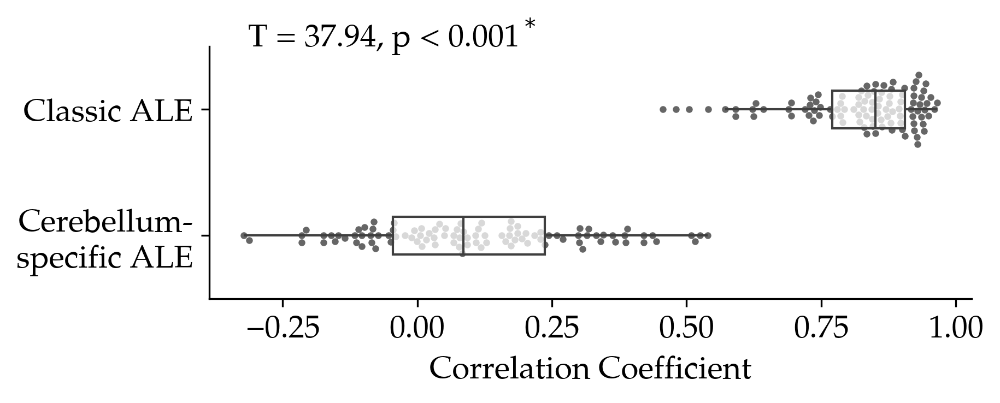

In [15]:
fig, ax = plt.subplots(figsize=(6, 2))
plot_data = prob_corr.unstack().reset_index()
sns.swarmplot(
    data=plot_data,
    y='level_0', x=0,
    s=3, color='.4',
    ax=ax
)
sns.boxplot(
    data=plot_data,
    y='level_0', x=0,
    showfliers=False,
    showcaps=False, width=0.3,
    boxprops={"facecolor": (1, 1, 1, 0.75)},
    ax=ax)
plt.setp(ax.collections, zorder=0, label="") # puts swarm in the back
ax.set_xlabel('Correlation Coefficient')
ax.set_yticklabels(['Classic ALE', 'Cerebellum-\nspecific ALE'])
ax.set_ylabel('')
sns.despine()
# add statistics
t, p = scipy.stats.ttest_rel(
    prob_corr['ALE'], 
    prob_corr['SALE'])
if p > 0.001:
    text = f'T = {t:.2f}, p = {p:.3f}'
else:
    text = f'T = {t:.2f}, p < 0.001'
if p < 0.05:
    text+=r'$^*$'
text_x = ax.get_xlim()[0]+(ax.get_xlim()[1]-ax.get_xlim()[0])*0.05
text_y = ax.get_ylim()[0]+(ax.get_ylim()[1]-ax.get_ylim()[0])*1
ax.text(text_x, text_y, 
        text,
        color='black',
        size=14,
        multialignment='left')

In [16]:
prob_corr.describe().round(2)

,ALE,SALE
count,101.00,101.00
mean,0.82,0.11
std,0.11,0.20
min,0.46,-0.32
25%,0.77,-0.05
50%,0.85,0.09
75%,0.91,0.24
max,0.96,0.54


# Full correlation matrices for NeuroSynth terms.

### Classic ALE

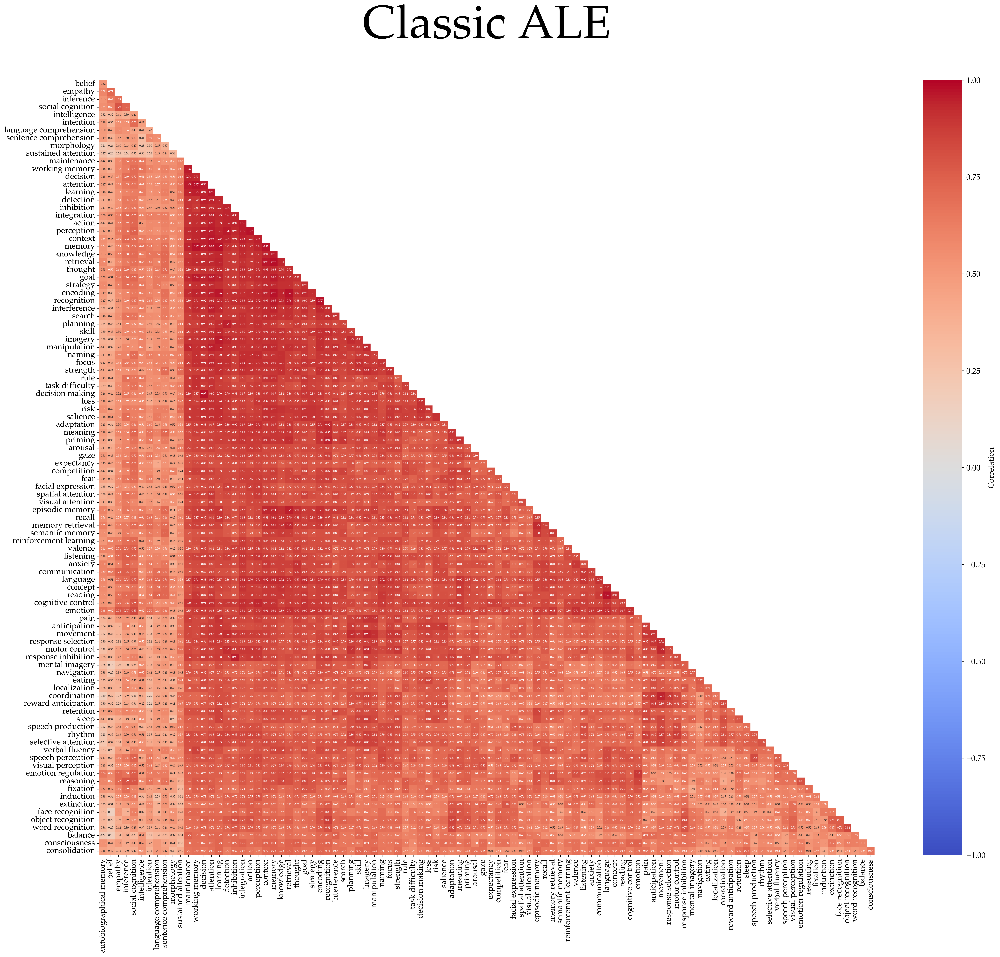

In [62]:
# Initialize the cross-correlation DataFrame
subbd_cross_corr = pd.DataFrame(surf_zmaps['ALE']).corr()
# Set clean labels
subbd_cross_corr.index = subbd_cross_corr.columns
# Hierarchical clustering
_, _, ordered_leaves = utils.hierarchical_clustering(subbd_cross_corr, no_plot=True)
# Reorder the correlation matrix
subbd_ordered_cross_corr = subbd_cross_corr.iloc[ordered_leaves, ordered_leaves]
# set diagonal and upper tirangle to nan
subbd_ordered_cross_corr.values[np.triu_indices_from(subbd_ordered_cross_corr, 0)] = np.NaN
# Plot the reordered correlation matrix using a heatmap
plt.figure(figsize=(30, 24))
ax = sns.heatmap(
    subbd_ordered_cross_corr, 
    annot=True, 
    fmt=".2f", 
    cmap='coolwarm', 
    cbar_kws={'label': 'Correlation'}, 
    annot_kws={"fontsize": 5}, 
    center=0.0, 
    square=True,
    vmin=-1,
    vmax=1,
    xticklabels=True, # force all tick labels
    yticklabels=True
)
# remove the trailing empty rows and columns
ax.set_xlim([0, subbd_cross_corr.shape[1]-1])
ax.set_ylim([subbd_cross_corr.shape[1], 1])
plt.title('Classic ALE', y = 1.05, fontsize = 80)
plt.show()

### Cerebellum-specific ALE

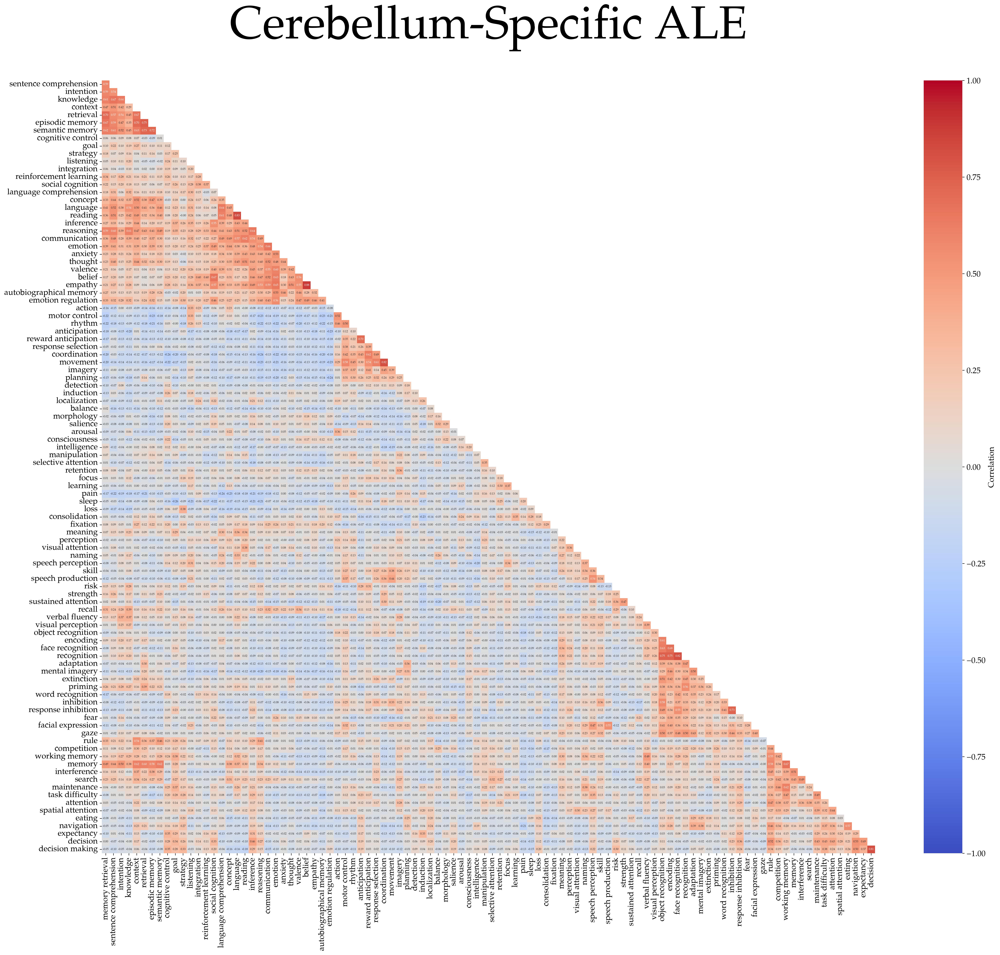

In [17]:
# Initialize the cross-correlation DataFrame
subbd_cross_corr = pd.DataFrame(surf_zmaps['SALE']).corr()
# Set clean labels
subbd_cross_corr.index = subbd_cross_corr.columns
# Hierarchical clustering
_, _, ordered_leaves = utils.hierarchical_clustering(subbd_cross_corr, no_plot=True)
# Reorder the correlation matrix
subbd_ordered_cross_corr = subbd_cross_corr.iloc[ordered_leaves, ordered_leaves]
# set diagonal and upper tirangle to nan
subbd_ordered_cross_corr.values[np.triu_indices_from(subbd_ordered_cross_corr, 0)] = np.NaN
# Plot the reordered correlation matrix using a heatmap
plt.figure(figsize=(30, 24))
ax = sns.heatmap(
    subbd_ordered_cross_corr, 
    annot=True, 
    fmt=".2f", 
    cmap='coolwarm', 
    cbar_kws={'label': 'Correlation'}, 
    annot_kws={"fontsize": 5}, 
    center=0.0, 
    square=True,
    vmin=-1,
    vmax=1,
    xticklabels=True, # force all tick labels
    yticklabels=True
)
# remove the trailing empty rows and columns
ax.set_xlim([0, subbd_cross_corr.shape[1]-1])
ax.set_ylim([subbd_cross_corr.shape[1], 1])
plt.title('Cerebellum-Specific ALE', y = 1.05, fontsize = 80)
plt.show()

# Figure 3 Neurosynth Supplements

In [18]:
# create figures directory
FIGURES_DIR = os.path.join(OUTPUT_DIR, 'Figures')
figure_dir = os.path.join(FIGURES_DIR, 'Figure3')
supplementary_dir = os.path.join(figure_dir, 'Supplementary')
os.makedirs(supplementary_dir, exist_ok=True)

## C-SALE maps for terms. Unthresholded maps with thresholded outlines. 

Term 'adaptation' thresholded map is empty. Skipping.
Term 'anticipation' thresholded map is empty. Skipping.
Term 'anxiety' thresholded map is empty. Skipping.
Term 'attention' thresholded map is empty. Skipping.
Term 'balance' thresholded map is empty. Skipping.
Term 'competition' thresholded map is empty. Skipping.
Term 'concept' thresholded map is empty. Skipping.
Term 'consciousness' thresholded map is empty. Skipping.
Term 'consolidation' thresholded map is empty. Skipping.
Term 'context' thresholded map is empty. Skipping.
Term 'decision' thresholded map is empty. Skipping.
Term 'decision making' thresholded map is empty. Skipping.
Term 'detection' thresholded map is empty. Skipping.
Term 'eating' thresholded map is empty. Skipping.
Term 'emotion regulation' thresholded map is empty. Skipping.
Term 'encoding' thresholded map is empty. Skipping.
Term 'expectancy' thresholded map is empty. Skipping.
Term 'extinction' thresholded map is empty. Skipping.
Term 'facial expression' thr

Text(0.11, 0.5, 'With Thresholded ($\\mathit{p}$ < .001 and $\\mathit{k}$ = 50) Overlays')

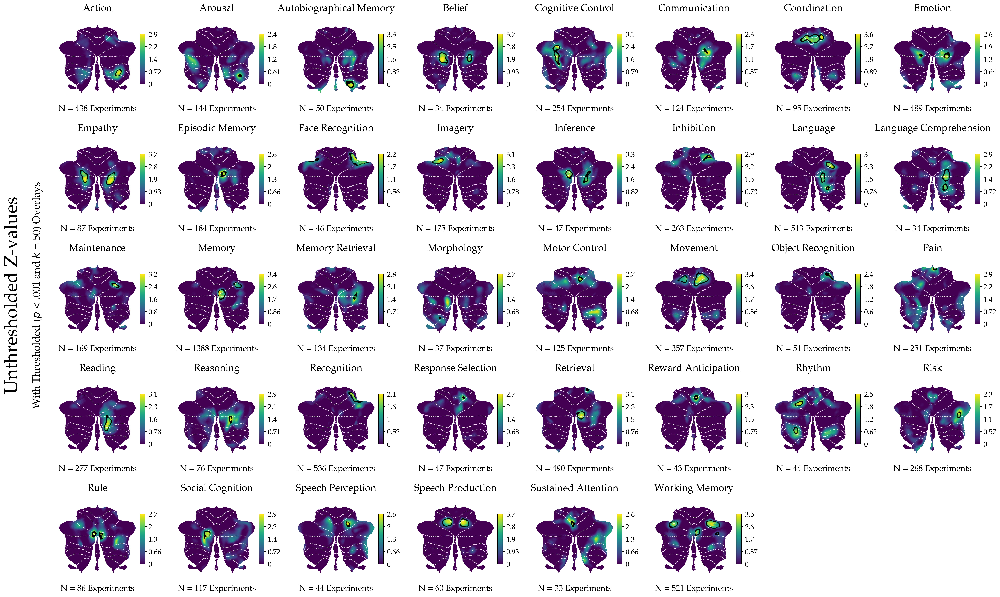

In [42]:
analysis = 'SALE'

# Create a new figure
fig = plt.figure(figsize=(32, 20))

# Make sure to only handle valid terms (with both maps available).
valid_terms = []

for term in utils.neurosynth_terms:
    # Check if both maps (unthresholded and thresholded) are available for the subdomain
    if term not in surf_zmaps[analysis]:
        print(f"Term '{term}' does not exist in unthresholded maps. Skipping.")
        continue
    if term not in surf_zmaps_thr[analysis]:
        print(f"Term '{term}' does not exist in thresholded maps. Skipping.")
        continue
    # Check if the thresholded map is completely empty (all values are zero)
    if np.all(surf_zmaps_thr[analysis][term] == 0):
        print(f"Term '{term}' thresholded map is empty. Skipping.")
        continue
    # If all checks pass, add the subdomain to valid_subdomains
    valid_terms.append(term)

# Order the valid terms based on domain and number of experiments
term_info = []
for term in valid_terms:
    # Get the number of experiments
    num_exps = stats.loc[term, "n_exp"]
    # Add to the list as a tuple (term, num_exps)
    term_info.append((term, num_exps))

# # Sort by number of experiments (ascending)
# term_info_sorted = sorted(term_info, key=lambda x: (x[1]))

# # Extract the sorted list of subdomains
# sorted_terms = [item[0] for item in term_info_sorted]
sorted_terms = [item[0] for item in term_info]

# Set the grid size
n_cols = 8 
n_rows = int(np.ceil(len(sorted_terms) / n_cols))

# Loop over sorted subdomains and create subplots
for i, term in enumerate(sorted_terms):
    ax = fig.add_subplot(n_rows, n_cols, i + 1)
    
    # Plot the unthresholded background map for each domain using a color blind-friendly colormap
    SUITPy.flatmap.plot(surf_zmaps[analysis][term], colorbar=True, new_figure=False, 
                        bordersize=0.5, cmap='viridis', bordercolor='white')

    # Overlay the cluster borders
    if term in surf_cluster_boundary_coords[analysis]:  # Ensure cluster boundary coordinates exist
        ax.plot(surf_cluster_boundary_coords[analysis][term][:, 0], 
                surf_cluster_boundary_coords[analysis][term][:, 1], 
                color='black', marker='.', linestyle=None, markersize=0.01, linewidth=0)

    # Set titles and labels as desired
    # ax.set_title(term.title().replace(' ', '\n'), fontsize=18)
    ax.set_title(term.title(), fontsize=19, y=0.95)
    ax.text(0.5, 0.0, f'N = {stats.loc[term, "n_exp"]} Experiments', fontsize=16, 
            ha='center', va='center', transform=ax.transAxes)

# Add a rotated y-label for the entire plot
fig.text(0.09, 0.5, 'Unthresholded Z-values', va='center', ha='center', rotation='vertical', fontsize=35)

# Add a subtitle for the y-label
fig.text(0.11, 0.5, 'With Thresholded ($\mathit{p}$ < .001 and $\mathit{k}$ = 50) Overlays', 
         va='center', ha='center', rotation='vertical', fontsize=20)

## Comparison to BrainMap results

Load maps of Neurosynth uncorrected results, transform to 2mm space and mask:

In [23]:
proper_mask_2mm = nibabel.load(os.path.join(INPUT_DIR, 'maps', 'D2009_MNI_2mm.nii.gz'))

neurosynth_masked = {}
for term in utils.neurosynth_terms:
    print(term)
    # load
    z_path = os.path.join(OUTPUT_DIR, 'SALE', 'Neurosynth', term.replace(' ', ''), 'uncorr_z.nii.gz')
    z_nii = nibabel.load(z_path)
    # transform to MNI 2mm space
    z_2mm = nilearn.image.resample_to_img(z_nii, proper_mask_2mm)
    # get within-mask values
    neurosynth_masked[term] = z_2mm.get_fdata()[np.isclose(proper_mask_2mm.get_fdata(), 1)]

action
adaptation
anticipation
anxiety
arousal
attention
autobiographical memory
balance
belief
cognitive control
communication
competition
concept
consciousness
consolidation
context
coordination
decision
decision making
detection
eating
emotion
emotion regulation
empathy
encoding
episodic memory
expectancy
extinction
face recognition
facial expression
fear
fixation
focus
gaze
goal
imagery
induction
inference
inhibition
integration
intelligence
intention
interference
knowledge
language
language comprehension
learning
listening
localization
loss
maintenance
manipulation
meaning
memory
memory retrieval
mental imagery
morphology
motor control
movement
naming
navigation
object recognition
pain
perception
planning
priming
reading
reasoning
recall
recognition
reinforcement learning
response inhibition
response selection
retention
retrieval
reward anticipation
rhythm
risk
rule
salience
search
selective attention
semantic memory
sentence comprehension
skill
sleep
social cognition
spatial atte

In [31]:
if os.path.exists(os.path.join(supplementary_dir, 'z_neurosynth_posneg_r.csv')) and os.path.exists(os.path.join(supplementary_dir, 'z_neurosynth_posneg_p.csv')):
    # Load correlations and p-values from csv
    r = pd.read_csv(os.path.join(supplementary_dir, 'z_neurosynth_posneg_r.csv'), index_col=0)
    p = pd.read_csv(os.path.join(supplementary_dir, 'z_neurosynth_posneg_p.csv'), index_col=0)
    # Display the resulting dataframes
    print(r)
    print(p)
else: 
    mask_data = proper_mask_2mm.get_fdata().astype('bool')
    # Initialize dataframes
    r = pd.DataFrame(index=neurosynth_masked.keys(), dtype=float)
    p = pd.DataFrame(index=neurosynth_masked.keys(), dtype=float)
    surrogates_paths = sorted(glob.glob(os.path.join(OUTPUT_DIR,
        'SALE/*/*/uncorr_z_2mm_mask-D2009_MNI_surrogates-variogram_n-1000.npy')
    ))
    for surrogates_path in tqdm(surrogates_paths):
        # Extract subbd using regex
        subbd_match = re.search(r'SALE/(.*?)/(.*?)/', surrogates_path)
        if subbd_match:
            subbd = subbd_match.group(2)
        else:
            print(f"Failed to parse subbd from path: {surrogates_path}")
            continue
        # Load z-map and mask it
        z_2mm = os.path.join(os.path.dirname(surrogates_path), 'uncorr_z_2mm.nii.gz')
        z_2mm_masked = nibabel.load(z_2mm).get_fdata()[mask_data]
        # Load surrogates
        surrogates = np.load(surrogates_path)
        # Calculate r and p between current z-map and every task
        for term in tqdm(neurosynth_masked.keys()):
            r.loc[term, subbd] = scipy.stats.pearsonr(z_2mm_masked, neurosynth_masked[term]).statistic
            # Create a null-distribution of correlations
            null_dist = [scipy.stats.pearsonr(surrogates[i, :], neurosynth_masked[term]).statistic for i in range(1000)]
            # and calculate target-correlation p-values based on this distribution
            p.loc[term, subbd] = (np.abs(null_dist) >= np.abs(r.loc[term, subbd])).mean()
    # Display the resulting dataframes
    print(r)
    print(p)
    # Save correlations and p-values to csv
    r.to_csv(os.path.join(supplementary_dir, 'z_neurosynth_posneg_r.csv'))
    p.to_csv(os.path.join(supplementary_dir, 'z_neurosynth_posneg_p.csv'))

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 38/38 [40:48<00:00, 64.42s/it]

                   Action.Execution.Speech  Action.Execution  \
action                            0.046069          0.319131   
adaptation                       -0.078144         -0.062427   
anticipation                     -0.041347          0.153479   
anxiety                          -0.079558         -0.161786   
arousal                          -0.092644         -0.017226   
...                                    ...               ...   
verbal fluency                    0.161668          0.049523   
visual attention                  0.100938          0.053531   
visual perception                -0.038355          0.014454   
word recognition                 -0.087417         -0.057956   
working memory                    0.012961         -0.087037   

                   Action.Imagination  Action.Inhibition  Action.Observation  \
action                      -0.029817           0.061838            0.200049   
adaptation                  -0.072664           0.126411            0.0

In [32]:
r = r.T
p = p.T

In [33]:
# FDR correction
sig_fdr, p_fdr = statsmodels.stats.multitest.fdrcorrection(p.values.flatten())
# reshape 
p_fdr = pd.DataFrame(p_fdr.reshape(p.shape), index=p.index, columns=p.columns)
sig_fdr = pd.DataFrame(sig_fdr.reshape(p.shape), index=p.index, columns=p.columns)

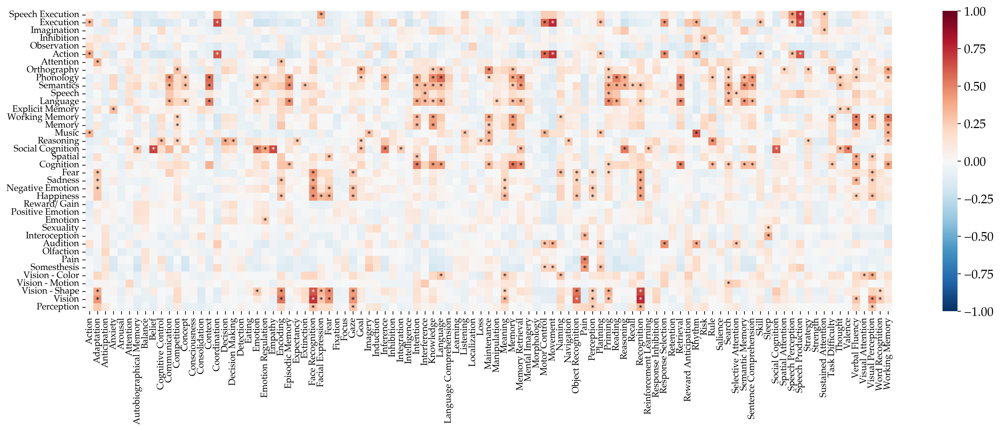

In [34]:
# plot the reordered data
fig, ax = plt.subplots(figsize=(20, 6))
sns.heatmap(r, cmap='RdBu_r',linecolor='.8', vmin=-1, vmax=1, ax=ax)
ax.set_xticks(np.arange(r.shape[1])+0.5)
ax.set_xticklabels(r.columns.str.title(), rotation=90, horizontalalignment='center', fontsize=10)
ax.set_yticks(np.arange(r.shape[0])+0.5)
ax.set_yticklabels(utils.bd_labels.loc[r.index].values, rotation=0, fontsize=10)
ax.set_ylabel('')

# add the * layer
for x, col in enumerate(r.columns):
    for y, row in enumerate(r.index):
        if sig_fdr.loc[row, col]: # Use the FDR-corrected p-values.
            text = r'$*$'
            # Conditional color based on the value of r
            text_color = 'white' if r.loc[row, col] > 0.6 or r.loc[row, col] < -0.6  else 'black'
            ax.text(x+0.5, y+0.6,
                    text, 
                    fontsize=8,
                    color=text_color,
                    horizontalalignment='center', 
                    verticalalignment='center')

In [35]:
sig_pairs = np.array(np.where(sig_fdr)).T
sig_pairs_str = pd.DataFrame(zip(r.index[sig_pairs[:, 0]], r.columns[sig_pairs[:, 1]]))
sig_pairs_str = sig_pairs_str.groupby(0).apply(lambda c: ', '.join(c[1].values)).to_dict()
for bm, ns in sig_pairs_str.items():
    print(f'{bm}: {ns}'.title())

Action: Action, Coordination, Motor Control, Movement, Planning, Response Selection, Rhythm, Skill, Speech Perception, Speech Production
Action.Execution: Action, Coordination, Motor Control, Movement, Planning, Response Selection, Rhythm, Skill, Speech Perception, Speech Production
Action.Execution.Speech: Facial Expression, Speech Perception, Speech Production, Sustained Attention
Action.Imagination: Sustained Attention
Action.Inhibition: Risk
Cognition: Episodic Memory, Intention, Knowledge, Language, Maintenance, Memory, Memory Retrieval, Priming, Retrieval, Rule, Search, Semantic Memory, Sentence Comprehension, Task Difficulty, Verbal Fluency, Working Memory
Cognition.Attention: Adaptation, Encoding
Cognition.Language: Communication, Concept, Context, Emotion, Episodic Memory, Intention, Interference, Knowledge, Language, Manipulation, Memory, Memory Retrieval, Priming, Reading, Recognition, Retrieval, Search, Semantic Memory, Sentence Comprehension
Cognition.Language.Orthography:

Plot top corresponding maps next to each other:

In [36]:
sig_pairs = np.array(np.where(sig_fdr)).T
sig_pairs = pd.DataFrame(zip(
    r.index[sig_pairs[:, 0]], 
    r.columns[sig_pairs[:, 1]], 
    r.values[sig_pairs[:, 0], sig_pairs[:, 1]],
    p_fdr.values[sig_pairs[:, 0], sig_pairs[:, 1]],
), columns=['BrainMap', 'Neurosynth', 'r', 'p_fdr'])
sig_pairs = sig_pairs.sort_values('r', ascending=False).reset_index(drop=True)
demo_pairs = []
demo_brainmap = []
demo_neurosynth = []
for _, row in sig_pairs.iterrows():
    if (row['BrainMap'] not in demo_brainmap) and (row['Neurosynth'] not in demo_neurosynth):
        demo_pairs.append(row)
        demo_brainmap.append(row['BrainMap'])
        demo_neurosynth.append(row['Neurosynth'])
    if len(demo_pairs) == 10:
        break
demo_pairs = pd.DataFrame(demo_pairs).reset_index(drop=True)
demo_pairs

,BrainMap,Neurosynth,r,p_fdr
0,Action.Execution,movement,0.749188,0.0
1,Perception.Vision,recognition,0.744428,0.0
2,Action.Execution.Speech,speech production,0.709477,0.0
3,Cognition.SocialCognition,belief,0.676965,0.0
4,Action,coordination,0.626008,0.0
5,Perception.Vision.Shape,face recognition,0.625630,0.0
6,Cognition.Music,rhythm,0.595012,0.0
7,Cognition.Language.Phonology,language,0.569793,0.0
8,Cognition,memory,0.541167,0.0
9,Cognition.Language.Semantics,context,0.538449,0.0


In [37]:
# load BrainMap data of demo pairs
bm_surf_zmaps = {}
bm_surf_zmaps_thr = {}
bm_surf_cluster_boundary_coords = {}

for bd in demo_pairs.loc[:,'BrainMap']:
    print(f"Loading {analysis} results for {bd}")
    domain, subdomain_name = (bd+'.').split('.', 1)
    subdomain_name = subdomain_name.rstrip('.')
    if subdomain_name == '':
        subdomain_name = None
    try:
        results = utils.load_results(analysis, domain, subdomain=subdomain_name)
    except FileNotFoundError:
        print(f"(Un)corrected {analysis} results not found for {subdomain}")
        continue
    bm_surf_zmaps[bd] = results[analysis][bd]['uncorr']
    bm_surf_zmaps_thr[bd] = results[analysis][bd]['corr']
    surf_cluster_mask = (bm_surf_zmaps_thr[bd] > 0).astype(int)
    bm_surf_cluster_boundary_coords[bd] = utils.get_flatmap_mask_boundary_coords(surf_cluster_mask)

Loading SALE results for Action.Execution
Loading SALE results for Perception.Vision
Loading SALE results for Action.Execution.Speech
Loading SALE results for Cognition.SocialCognition
Loading SALE results for Action
Loading SALE results for Perception.Vision.Shape
Loading SALE results for Cognition.Music
Loading SALE results for Cognition.Language.Phonology
Loading SALE results for Cognition
Loading SALE results for Cognition.Language.Semantics


In [38]:
bm_stats = pd.read_csv(os.path.join(OUTPUT_DIR, 'exp_stats.csv'), index_col=0)

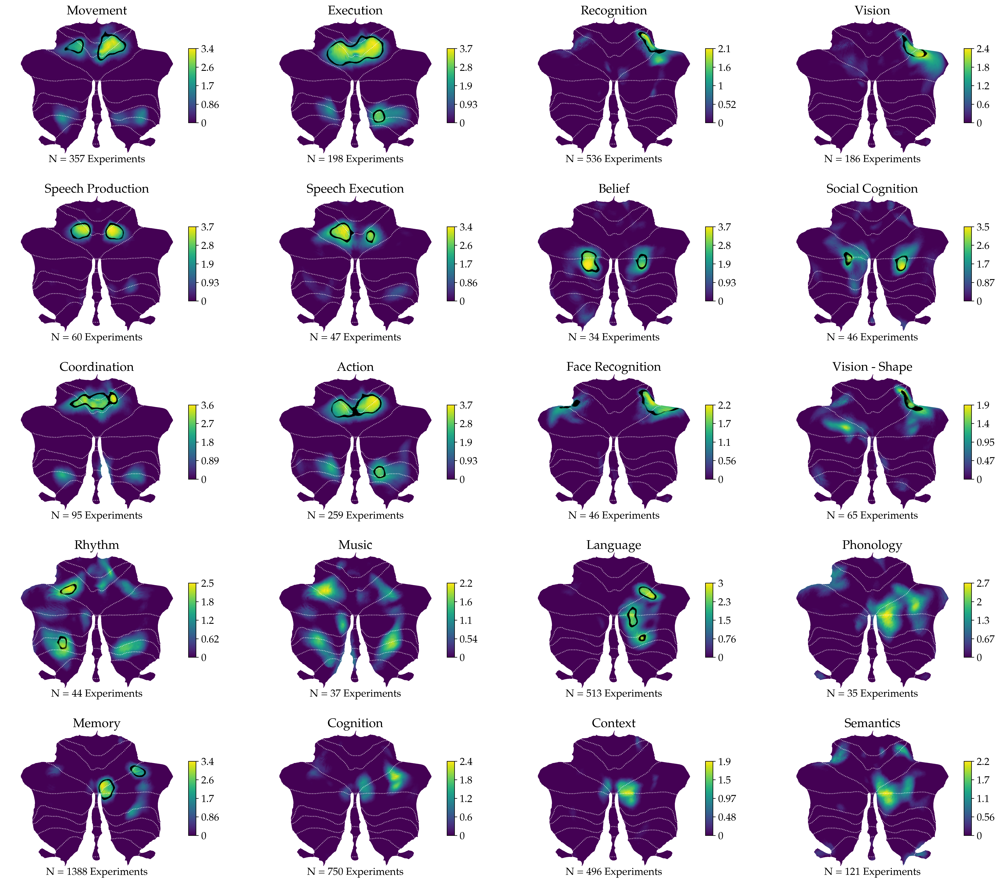

In [40]:
# Create a new figure
fig = plt.figure(figsize=(24, 21))

# Set the grid size
n_cols = 4 
n_rows = 5

# Loop over sorted subdomains and create subplots
for i, pair in demo_pairs.iterrows():
    # neurosynth
    term = pair['Neurosynth']
    ax = fig.add_subplot(n_rows, n_cols, i*2+1)
    SUITPy.flatmap.plot(surf_zmaps['SALE'][term], colorbar=True, new_figure=False, 
                        bordersize=0.5, cmap='viridis', bordercolor='white')
    # significance boundary (if it exists)
    if term in surf_cluster_boundary_coords[analysis]:
        ax.plot(surf_cluster_boundary_coords['SALE'][term][:, 0], 
                surf_cluster_boundary_coords['SALE'][term][:, 1], 
                color='black', marker='.', linestyle=None, markersize=0.01, linewidth=0)
    # title and n experimetns
    ax.set_title(term.title(), fontsize=17, y=0.95)
    ax.text(0.5, 0.0, f'N = {stats.loc[term, "n_exp"]} Experiments', fontsize=14, 
            ha='center', va='center', transform=ax.transAxes)

    # braimmap
    ax = fig.add_subplot(n_rows, n_cols, i*2+2)
    bd = pair['BrainMap']
    SUITPy.flatmap.plot(bm_surf_zmaps[bd], colorbar=True, new_figure=False, 
                        bordersize=0.5, cmap='viridis', bordercolor='white')
    # significance boundary (if it exists)
    if bd in bm_surf_cluster_boundary_coords:
        ax.plot(bm_surf_cluster_boundary_coords[bd][:, 0], 
                bm_surf_cluster_boundary_coords[bd][:, 1], 
                color='black', marker='.', linestyle=None, markersize=0.01, linewidth=0)
    # title and n experimetns
    ax.set_title(utils.bd_labels.loc[bd], fontsize=17, y=0.95)
    ax.text(0.5, 0.0, f'N = {bm_stats.loc[bd, "n_exp"]} Experiments', fontsize=14, 
            ha='center', va='center', transform=ax.transAxes)